# Exercise 6.2: Writing your own segmentation function

<hr>

As you probably noticed during the previous two lessons, there are often a lot of small operations that are sometimes necessary before you can even extract the useful data from the image! Rather than writing out each step whenever you want to process an image, you should write a boilerplate function that can be used to segment *any* phase contrast image of bacteria. Your function should execute the following steps.

>1. Correct for "hot" or "bad" pixels in an image. 
2. Correct for uneven illumination. 
3. Perform a thresholding operation.
4. Remove bacteria or objects near/touching the image border. 
5. Remove objects that are too large (or too small) to be bacteria. Think carefully! For a multipurpose function, would you *always* want the same area cutoff?
6. Remove improperly segmented cells.
7. Return a labeled segmentation mask. 

A set of discrete operations like this is called a **pipeline**. It is usefull to think of image processing, or data processing for that matter, as a pipeline consisting of successive steps. This helps codify how you are extracting conclusions from your data and improves reproducibility.

After putting your pipeline into a function, run the pipeline on both the *Bacillus subtilis* ([Lesson 44](l44_intro_to_image_processing.ipynb)) and the *E. coli* [Lesson 45](l45_segmentation.ipynb) image sets. Does your function work well in both cases? Note that in both of these image sets, the interpixel distance is 0.0626 µm per pixel. 

<br />

## Solution 

<hr>

<img src='data:image/png;base64,iVBORw0KGgoAAAANSUhEUgAAAEAAAABACAYAAACqaXHeAAAABHNCSVQICAgIfAhkiAAAAAlwSFlz
AAAB+wAAAfsBxc2miwAAABl0RVh0U29mdHdhcmUAd3d3Lmlua3NjYXBlLm9yZ5vuPBoAAA6zSURB
VHic7ZtpeFRVmsf/5966taWqUlUJ2UioBBJiIBAwCZtog9IOgjqACsogKtqirT2ttt069nQ/zDzt
tI4+CrJIREFaFgWhBXpUNhHZQoKBkIUASchWla1S+3ar7r1nPkDaCAnZKoQP/D7mnPOe9/xy76n3
nFSAW9ziFoPFNED2LLK5wcyBDObkb8ZkxuaoSYlI6ZcOKq1eWFdedqNzGHQBk9RMEwFAASkk0Xw3
ETacDNi2vtvc7L0ROdw0AjoSotQVkKSvHQz/wRO1lScGModBFbDMaNRN1A4tUBCS3lk7BWhQkgpD
lG4852/+7DWr1R3uHAZVQDsbh6ZPN7CyxUrCzJMRouusj0ipRwD2uKm0Zn5d2dFwzX1TCGhnmdGo
G62Nna+isiUqhkzuKrkQaJlPEv5mFl2fvGg2t/VnzkEV8F5ioioOEWkLG86fvbpthynjdhXYZziQ
x1hC9J2NFyi8vCTt91Fh04KGip0AaG9zuCk2wQCVyoNU3Hjezee9bq92duzzTmxsRJoy+jEZZZYo
GTKJ6SJngdJqAfRzpze0+jHreUtPc7gpBLQnIYK6BYp/uGhw9YK688eu7v95ysgshcg9qSLMo3JC
4jqLKQFBgdKDPoQ+Pltb8dUyQLpeDjeVgI6EgLIQFT5tEl3rn2losHVsexbZ3EyT9wE1uGdkIPcy
BGxn8QUq1QrA5nqW5i2tLqvrrM9NK6AdkVIvL9E9bZL/oyfMVd/jqvc8LylzRBKDJSzIExwhQzuL
QYGQj4rHfFTc8mUdu3E7yoLtbTe9gI4EqVgVkug2i5+uXGo919ixbRog+3fTbQ8qJe4ZOYNfMoTI
OoshUNosgO60AisX15aeI2PSIp5KiFLI9ubb1vV3Qb2ltwLakUCDAkWX7/nHKRmmGIl9VgYsUhJm
2NXjKYADtM1ygne9QQDIXlk49FBstMKx66D1v4+XuQr7vqTe0VcBHQlRWiOCbmmSYe2SqtL6q5rJ
zsTb7lKx3FKOYC4DoqyS/B5bvLPxvD9Qtf6saxYLQGJErmDOdOMr/zo96km1nElr8bmPOBwI9COv
HnFPRIwmkSOv9kcAS4heRsidOkpeWBgZM+UBrTFAXNYL5Vf2ii9c1trNzpYdaoVil3WIc+wdk+gQ
noie3ecCcxt9ITcLAPWt/laGEO/9U6PmzZkenTtsSMQ8uYywJVW+grCstAvCIaAdArAsIWkRDDs/
KzLm2YcjY1Lv0UdW73HabE9n6V66cxSzfEmuJssTpKGVp+0vHq73FwL46eOjpMpbRAnNmJFrGJNu
Ukf9Yrz+3rghiumCKNXXWPhLYcjxGsIpoCMsIRoFITkW8AuyM8jC1+/QLx4bozCEJIq38+1rtpR6
V/yzb8eBlRb3fo5l783N0CWolAzJHaVNzkrTzlEp2bQ2q3TC5gn6wpnoQAmwSiGh2GitnTmVMc5O
UyfKWUKCIsU7+fZDKwqdT6DDpvkzAX4/+AMFjk0tDp5GRXLpQ2MUmhgDp5gxQT8+Y7hyPsMi8uxF
71H0oebujHALECjFKaW9Lm68n18wXp2kVzIcABytD5iXFzg+WVXkegpAsOOYziqo0OkK76GyquC3
ltZAzMhhqlSNmmWTE5T6e3IN05ITFLM4GdN0vtZ3ob8Jh1NAKXFbm5PtLU/eqTSlGjkNAJjdgn/N
aedXa0tdi7+t9G0FIF49rtMSEgAs1kDLkTPO7ebm4IUWeyh1bKomXqlgMG6kJmHcSM0clYLJ8XtR
1GTnbV3F6I5wCGikAb402npp1h1s7LQUZZSMIfALFOuL3UUrfnS8+rez7v9qcold5tilgHbO1fjK
9ubb17u9oshxzMiUBKXWqJNxd+fqb0tLVs4lILFnK71H0Ind7uiPgACVcFJlrb0tV6DzxqqTIhUM
CwDf1/rrVhTa33/3pGPxJYdQ2l2cbgVcQSosdx8uqnDtbGjh9SlDVSMNWhlnilfqZk42Th2ZpLpf
xrHec5e815zrr0dfBZSwzkZfqsv+1FS1KUknUwPARVvItfKUY+cn57yP7qv07UE3p8B2uhUwLk09
e0SCOrK+hbdYHYLjRIl71wWzv9jpEoeOHhGRrJAzyEyNiJuUqX0g2sBN5kGK6y2Blp5M3lsB9Qh4
y2Ja6x6+i0ucmKgwMATwhSjdUu49tKrQ/pvN5d53ml2CGwCmJipmKjgmyuaXzNeL2a0AkQ01Th5j
2DktO3Jyk8f9vcOBQHV94OK+fPumJmvQHxJoWkaKWq9Vs+yUsbq0zGT1I4RgeH2b5wef7+c7bl8F
eKgoHVVZa8ZPEORzR6sT1BzDUAD/d9F78e2Tzv99v8D+fLVTqAKAsbGamKey1Mt9Ann4eH3gTXTz
idWtAJ8PQWOk7NzSeQn/OTHDuEikVF1R4z8BQCy+6D1aWRfY0tTGG2OM8rRoPaeIj5ZHzJxszElN
VM8K8JS5WOfv8mzRnQAKoEhmt8gyPM4lU9SmBK1MCQBnW4KONT86v1hZ1PbwSXPw4JWussVjtH9Y
NCoiL9UoH/6PSu8jFrfY2t36erQHXLIEakMi1SydmzB31h3GGXFDFNPaK8Rme9B79Ixrd0WN+1ij
NRQ/doRmuFLBkHSTOm5GruG+pFjFdAmorG4IXH1Qua6ASniclfFtDYt+oUjKipPrCQB7QBQ2lrgP
fFzm+9XWUtcqJ3/5vDLDpJ79XHZk3u8nGZ42qlj1+ydtbxysCezrydp6ugmipNJ7WBPB5tydY0jP
HaVNzs3QzeE4ZpTbI+ZbnSFPbVOw9vsfnVvqWnirPyCNGD08IlqtYkh2hjZ5dErEQzoNm+6ykyOt
Lt5/PQEuSRRKo22VkydK+vvS1XEKlhCJAnsqvcVvH7f/ZU2R67eXbMEGAMiIV5oWZWiWvz5Fv2xG
sjqNJQRvn3Rs2lji/lNP19VjAQDgD7FHhujZB9OGqYxRkZxixgRDVlqS6uEOFaJUVu0rPFzctrnF
JqijImVp8dEKVWyUXDk92zAuMZ6bFwpBU1HrOw6AdhQgUooChb0+ItMbWJitSo5Ws3IAOGEOtL53
0vHZih9sC4vtofZ7Qu6523V/fmGcds1TY3V36pUsBwAbSlxnVh2xLfAD/IAIMDf7XYIkNmXfpp2l
18rkAJAy9HKFaIr/qULkeQQKy9zf1JgDB2uaeFNGijo5QsUyacNUUTOnGO42xSnv4oOwpDi1zYkc
efUc3I5Gk6PhyTuVKaOGyLUAYPGIoY9Pu/atL/L92+4q9wbflRJ2Trpm/jPjdBtfnqB/dIThcl8A
KG7hbRuKnb8qsQsVvVlTrwQAQMUlf3kwJI24Z4JhPMtcfng5GcH49GsrxJpGvvHIaeem2ma+KSjQ
lIwUdYyCY8j4dE1KzijNnIP2llF2wcXNnsoapw9XxsgYAl6k+KzUXbi2yP3KR2ecf6z3BFsBICdW
nvnIaG3eHybqX7vbpEqUMT+9OL4Qpe8VON7dXuFd39v19FoAABRVePbGGuXTszO0P7tu6lghUonE
llRdrhArLvmKdh9u29jcFiRRkfLUxBiFNiqSU9icoZQHo5mYBI1MBgBH6wMNb+U7Pnw337H4gi1Y
ciWs+uks3Z9fztUvfzxTm9Ne8XXkvQLHNytOOZeiD4e0PgkAIAYCYknKUNUDSXEKzdWNpnil7r4p
xqkjTarZMtk/K8TQ6Qve78qqvXurGwIJqcOUKfUWHsm8KGvxSP68YudXq4pcj39X49uOK2X142O0
Tz5/u/7TVybqH0rSya6ZBwD21/gubbrgWdDgEOx9W
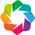

In [1]:
import numpy as np

import skimage.io
import skimage.segmentation
import skimage.morphology

import holoviews as hv
hv.extension('bokeh')

Many of our image processing functions will come from  `scikit-image`. The function below calls on functions from these packages directly. This is a wonderful example of the power of modular programming—each operation performs a single task!

In [2]:
def cell_segmenter(
    im,
    thresh="otsu",
    radius=20.0,
    image_mode="phase",
    area_bounds=(0, 1e7),
    ecc_bounds=(0, 1),
):
    """
    This function segments a given image via thresholding and returns
    a labeled segmentation mask.
    
    Parameters
    ----------
    im : 2d-array
        Image to be segmented. This may be of either float or integer
        data type.
    thresh : int, float, or 'otsu'
        Value used during thresholding operation. This can either be a value 
        (`int` or `float`) or 'otsu'. If 'otsu', the threshold value will be 
        determined automatically using Otsu's thresholding method.
    radius : float
        Radius for gaussian blur for background subtraction. Default value
        is 20.
    image_mode : 'phase' or 'fluorescence'
        Mode of microscopy used to capture the image. If 'phase', objects with 
        intensity values *lower* than the provided threshold will be selected. 
        If `fluorescence`, values *greater* than the provided threshold will be 
        selected. Default value is 'phase'.
    area_bounds : tuple of ints.
        Range of areas of acceptable objects. This should be provided in units 
        of square pixels.
    ecc_bounds : tuple of floats
        Range of eccentricity values of acceptable objects. These values should
        range between 0.0 and 1.0.
        
    Returns
    -------
    im_labeled : 2d-array, int
        Labeled segmentation mask.
    """
    # Apply a median filter to remove hot pixels.
    med_selem = skimage.morphology.square(3)
    im_filt = skimage.filters.median(im, footprint=med_selem)

    # Perform gaussian subtraction
    im_sub = bg_subtract(im_filt, radius)

    # Determine the thresholding method.
    if thresh == "otsu":
        thresh = skimage.filters.threshold_otsu(im_sub)

    # Determine the image mode and apply threshold.
    if image_mode == "phase":
        im_thresh = im_sub < thresh
    elif image_mode == "fluorescence":
        im_thresh = im_sub > thresh
    else:
        raise ValueError(
            "image mode not recognized. Must be 'phase'" + " or 'fluorescence'"
        )

    # Label the objects.
    im_label = skimage.measure.label(im_thresh)

    # Apply the area and eccentricity bounds.
    im_filt = area_ecc_filter(im_label, area_bounds, ecc_bounds)

    # Remove objects touching the border.
    im_border = skimage.segmentation.clear_border(im_filt, buffer_size=5)

    # Relabel the image.
    im_border = im_border > 0

    return skimage.measure.label(im_border)


def bg_subtract(im, radius):
    """
    Subtracts a gaussian blurred image from itself smoothing uneven 
    illumination.
    
    Parameters
    ----------
    im : 2d-array
        Image to be subtracted
    radius : int or float
        Radius of gaussian blur
    
    Returns
    -------
    im_sub : 2d-array, float
        Background subtracted image.
    """
    # Apply the gaussian filter.
    im_filt = skimage.filters.gaussian(im, radius)

    # Ensure the original image is a float
    if np.max(im) > 1.0:
        im = skimage.img_as_float(im)

    return im - im_filt


def area_ecc_filter(im, area_bounds, ecc_bounds):
    """
    Filters objects in an image based on their areas.
    
    Parameters
    ----------
    im : 2d-array, int
        Labeled segmentation mask to be filtered. 
    area_bounds : tuple of ints
        Range of areas in which acceptable objects exist. This should be 
        provided in units of square pixels.
    ecc_bounds : tuple of floats 
        Range of eccentricities in which acceptable objects exist. This should be 
        provided on the range of 0 to 1.0.
        
    Returns
    -------
    im_relab : 2d-array, int
        The relabeled, filtered image.
    """

    # Extract the region props of the objects.
    props = skimage.measure.regionprops(im)

    # Extract the areas and labels.
    areas = np.array([prop.area for prop in props])
    eccs = np.array([prop.eccentricity for prop in props])
    labels = np.array([prop.label for prop in props])

    # Make an empty image to add the approved cells.
    im_approved = np.zeros_like(im)

    # Threshold the objects based on area and eccentricity
    for i, _ in enumerate(areas):
        if (
            areas[i] > area_bounds[0]
            and areas[i] < area_bounds[1]
            and eccs[i] > ecc_bounds[0]
            and eccs[i] < ecc_bounds[1]
        ):
            im_approved += im == labels[i]

    # Relabel the image.
    return skimage.measure.label(im_approved > 0)

In the previous code block, we defined a few functions. I could have thrown all components into a single function, but keeping modularity is important. The filtering functions will make application of area and eccentricity bounds easier especially if I want to use them again in the future. The important function here is `cell_segmenter()` which actually calls the two filtering functions we wrote above! Let's try them out on some test images. 

In [3]:
# Load a B. subtilis and E. coli test image.
ecoli = skimage.io.imread("data/HG105_images/noLac_phase_0004.tif")
bsub_phase = skimage.io.imread("data/bsub_100x_phase.tif")
bsub_fluo = skimage.io.imread("data/bsub_100x_cfp.tif")

# Using my knowledge of biology, we can draw some bounds.
ip_dist = 0.0626  # in units of µm per pixel.
area_bounds = (1 / ip_dist ** 2, 10.0 / ip_dist ** 2)
ecc_bounds = (0.8, 1.0)  # they are certainly not spheres.

# Pass all images through our function.
ecoli_seg = cell_segmenter(
    ecoli, area_bounds=area_bounds, ecc_bounds=ecc_bounds
)
bsub_phase_seg = cell_segmenter(
    bsub_phase,
    image_mode="phase",
    area_bounds=area_bounds,
    ecc_bounds=ecc_bounds,
)
bsub_fluo_seg = cell_segmenter(
    bsub_fluo,
    image_mode="fluorescence",
    area_bounds=area_bounds,
    ecc_bounds=ecc_bounds,
)

We can make merged images to see how well we segmented all of the objects. Since this would be hard to see on the *Bacillus* fluorescence image directly, we'll take a look at the fluorescence segmentation on the corresponding phase image.

In [4]:
# Make the two phase images as floats and copy them.
ecoli_float = ecoli / ecoli.max()
bsub_float = bsub_phase / bsub_phase.max()
ecoli_copy = np.copy(ecoli_float)
bsub_copy = np.copy(bsub_float)
bsub_copy2 = np.copy(bsub_float)

# Mark the segmented bacteria on the copied images.
ecoli_copy[ecoli_seg > 0] = 0.8
bsub_copy[bsub_phase_seg > 0] = 0.8
bsub_copy2[bsub_fluo_seg > 0] = 0.8

# Merge them into RGB images.
ecoli_merge = np.dstack((ecoli_copy, ecoli_float, ecoli_float))
bsub_phase_merge = np.dstack((bsub_copy, bsub_float, bsub_float))
bsub_fluo_merge = np.dstack((bsub_copy2, bsub_float, bsub_float))

# Let's plot 'em!
frame_width = 200
frame_height = int(frame_width * ecoli.shape[0] / ecoli.shape[1])
opts = dict(
    frame_height=frame_height, frame_width=frame_width, xlabel="", ylabel=""
)
plots = [
    hv.RGB(im).opts(**opts)
    for im in [ecoli_merge, bsub_phase_merge, bsub_fluo_merge]
]

hv.Layout(plots).cols(1)

:Layout
   .RGB.I   :RGB   [x,y]   (R,G,B)
   .RGB.II  :RGB   [x,y]   (R,G,B)
   .RGB.III :RGB   [x,y]   (R,G,B)

That's actually pretty good! It's obvious that segmenting in fluorescence yields a better mask than in phase. Keep that in mind for your own experiments!

## Computing environment

In [5]:
%load_ext watermark
%watermark -v -p numpy,skimage,bokeh,holoviews,jupyterlab

Python implementation: CPython
Python version       : 3.11.3
IPython version      : 8.12.0

numpy     : 1.24.3
skimage   : 0.20.0
bokeh     : 3.1.1
holoviews : 1.16.2
jupyterlab: 3.6.3

